In [1]:
!python -m pip install pyyaml==5.1
# Detectron2 has not released pre-built binaries for the latest pytorch (https://github.com/facebookresearch/detectron2/issues/4053)
# so we install from source instead. This takes a few minutes.
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 6.4 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-3iaeulri
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-3iaeulri
  Resolved https://github.com/facebookresearch/detectron2.git to commit 10d074bfecc81653548511bf6eb903942ef32988
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50

In [15]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
import joblib
import matplotlib.pyplot as plt
import skimage.io as io
import albumentations as A
from sklearn.preprocessing import StandardScaler
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.config import CfgNode as CN
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.engine import DefaultTrainer
from detectron2.utils.visualizer import ColorMode
from detectron2.structures import BoxMode, PolygonMasks
from detectron2.evaluation import COCOEvaluator,SemSegEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetMapper

# Set base params
plt.rcParams["figure.figsize"] = [16,9]

import seaborn as sns
from matplotlib import colors
from tensorboard.backend.event_processing import event_accumulator as ea
from PIL import Image

In [3]:
import zipfile
import os

zip_file_name = "archive (9).zip"
destination_folder = "damage"

with zipfile.ZipFile(zip_file_name, 'r') as zip_ref:
    zip_ref.extractall(destination_folder)

In [4]:
train_dir = "/content/damage/train"
val_dir = "/content/damage/val"
test_dir = "/content/damage/test"

register_coco_instances("Train", {}, os.path.join(train_dir,"COCO_mul_train_annos.json"), os.path.join(train_dir))
register_coco_instances("Valid", {}, os.path.join(val_dir,"COCO_mul_val_annos.json"), os.path.join(val_dir))

damage_type_dataset_dicts = DatasetCatalog.get("Train")
damage_type_metadata_dicts = MetadataCatalog.get("Train")
damage_type_metadata_dicts

[03/05 13:40:20 d2.data.datasets.coco]: Loaded 59 images in COCO format from /content/damage/train/COCO_mul_train_annos.json


namespace(name='Train',
          json_file='/content/damage/train/COCO_mul_train_annos.json',
          image_root='/content/damage/train',
          evaluator_type='coco',
          thing_classes=['headlamp',
                         'rear_bumper',
                         'door',
                         'hood',
                         'front_bumper'],
          thing_dataset_id_to_contiguous_id={1: 0, 2: 1, 3: 2, 4: 3, 5: 4})

In [5]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("Train",)
cfg.DATASETS.TEST = ("Valid",)
cfg.INPUT.CROP.ENABLED = True
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 800
cfg.SOLVER.MAX_ITER = 3500
cfg.SOLVER.STEPS = (600,2000,3250)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 32
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg.MODEL.RETINANET.NUM_CLASSES = 5
cfg.TEST.EVAL_PERIOD = 400
cfg.SOLVER.CHECKPOINT_PERIOD = 400


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[03/05 13:40:24 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:01, 127MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[03/05 13:40:26 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/05 13:40:37 d2.utils.events]:  eta: 0:20:04  iter: 19  total_loss: 3.481  loss_cls: 1.742  loss_box_reg: 0.9147  loss_mask: 0.6943  loss_rpn_cls: 0.07153  loss_rpn_loc: 0.02175    time: 0.3407  last_time: 0.2688  data_time: 0.0686  last_data_time: 0.0124   lr: 2.1638e-06  max_mem: 1988M
[03/05 13:40:47 d2.utils.events]:  eta: 0:19:18  iter: 39  total_loss: 3.516  loss_cls: 1.715  loss_box_reg: 0.9816  loss_mask: 0.6938  loss_rpn_cls: 0.08647  loss_rpn_loc: 0.02598    time: 0.3316  last_time: 0.2725  data_time: 0.0117  last_data_time: 0.0120   lr: 3.3888e-06  max_mem: 1990M
[03/05 13:40:53 d2.utils.events]:  eta: 0:19:27  iter: 59  total_loss: 3.38  loss_cls: 1.666  loss_box_reg: 0.9069  loss_mask: 0.6938  loss_rpn_cls: 0.09073  loss_rpn_loc: 0.02464    time: 0.3357  last_time: 0.2911  data_time: 0.0117  last_data_time: 0.0058   lr: 4.6138e-06  max_mem: 1990M
[03/05 13:41:00 d2.utils.events]:  eta: 0:18:32  iter: 79  total_loss: 3.36  loss_cls: 1.573  loss_box_reg: 0.9495  loss_mask

In [28]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8 # set the testing threshold for this model
cfg.DATASETS.TEST = ("Valid", )
predictor = DefaultPredictor(cfg)

[03/05 14:13:40 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [7]:
evaluator = COCOEvaluator("Valid", cfg, False, output_dir="./output/")
test_loader = build_detection_test_loader(cfg, "Valid")
inference_on_dataset(predictor.model, test_loader, evaluator)

WARNING [03/05 14:01:58 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/05 14:01:58 d2.data.datasets.coco]: Loaded 11 images in COCO format from /content/damage/val/COCO_mul_val_annos.json
[03/05 14:01:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/05 14:01:58 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/05 14:01:58 d2.data.common]: Serializing 11 elements to byte tensors and concatenating them all ...
[03/05 14:01:58 d2.data.common]: Serialized dataset takes 0.01 MiB
[03/05 14:01:58 d2.evaluation.evaluator]: Start inference on 11 batches
[03/05 14:02:00 d2.evaluation.evaluator]: Inference done 11/11. Dataloading: 0.0014 s/iter. Inference: 0.0836 s/iter. Eval: 0.0070 s/iter. Total: 0.0920 s/iter. ETA=0:00

OrderedDict([('bbox',
              {'AP': 23.495756718528995,
               'AP50': 34.43894389438944,
               'AP75': 24.669966996699667,
               'APs': nan,
               'APm': 29.386138613861384,
               'APl': 21.41749174917492,
               'AP-headlamp': 21.122112211221122,
               'AP-rear_bumper': 0.0,
               'AP-door': 40.127298444130126,
               'AP-hood': 27.19471947194719,
               'AP-front_bumper': 29.034653465346533}),
             ('segm',
              {'AP': 24.941772748703443,
               'AP50': 32.09099481376709,
               'AP75': 29.054691183404056,
               'APs': nan,
               'APm': 34.2970297029703,
               'APl': 20.009900990099013,
               'AP-headlamp': 20.965346534653463,
               'AP-rear_bumper': 0.0,
               'AP-door': 42.85242809995285,
               'AP-hood': 30.594059405940595,
               'AP-front_bumper': 30.297029702970296})])

In [8]:
%load_ext tensorboard
%tensorboard --logdir ./output

<IPython.core.display.Javascript object>

In [9]:
dataset_dicts = DatasetCatalog.get("Valid")

[03/05 14:02:05 d2.data.datasets.coco]: Loaded 11 images in COCO format from /content/damage/val/COCO_mul_val_annos.json


In [10]:
import pandas as pd
def load_annotations(csv_file_path):
    annotations_df = pd.read_csv(csv_file_path)
    return annotations_df

def calculate_iou(box1, box2):
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2

    x_intersection = max(0, min(x1 + w1, x2 + w2) - max(x1, x2))
    y_intersection = max(0, min(y1 + h1, y2 + h2) - max(y1, y2))

    intersection_area = x_intersection * y_intersection
    union_area = w1 * h1 + w2 * h2 - intersection_area

    iou = intersection_area / union_area
    return iou

def assign_cost_for_damagedpart(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(5000, 10000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(3000, 5000)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(1000, 3000)
    else:
        return np.random.randint(100, 1000)

def assign_cost_for_headlamp(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(3000, 5000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(1500, 3000)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(500, 1500)
    else:
        return np.random.randint(100, 500)

def assign_cost_for_rearbumper(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(4000, 9000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(3500, 4000)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(2000, 3500)
    else:
        return np.random.randint(500, 2000)

def assign_cost_for_door(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(8000, 10000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(5000, 8000)   # Example repair cost for moderate IoU
    elif iou >= 0.5:
        return np.random.randint(3000, 5000)
    else:
        return np.random.randint(1000, 3000)

def assign_cost_for_hood(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(4000, 8000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(3000, 4000)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(1600, 3000)
    else:
        return np.random.randint(500, 1500)

def assign_cost_for_frontbumper(iou):
    # Define your logic for assigning repair costs for the 'door' category
    # Example: Assign higher repair cost for higher IoU
    if iou >= 0.7:
        return np.random.randint(5500, 10000)  # Example repair cost for high IoU
    elif iou >= 0.5:
        return np.random.randint(3000, 5500)   # Example repair cost for moderate IoU
    elif iou >= 0.3:
        return np.random.randint(1500, 3000)
    else:
        return np.random.randint(800, 1500)

def assign_repair_costs(category, iou_scores):
    repair_costs = []
    for iou in iou_scores:
        if category == 0:
            repair_costs.append(assign_cost_for_damagedpart(iou))
        elif category == 1:
            repair_costs.append(assign_cost_for_headlamp(iou))
        elif category == 2:
            repair_costs.append(assign_cost_for_rearbumper(iou))
        elif category == 3:
            repair_costs.append(assign_cost_for_door(iou))
        elif category == 4:
            repair_costs.append(assign_cost_for_hood(iou))
        elif category == 5:
            repair_costs.append(assign_cost_for_frontbumper(iou))
        else:
            # Default repair cost assignment
            repair_costs.append(np.random(500))  # Example repair cost for unknown category
    return repair_costs

def create_repair_cost_dataset(data):
    repair_dataset = []

    for _, annotation in data.iterrows():
        image_name = annotation['image_id']
        category_id = annotation['category']
        predicted_box = eval(annotation['predicted_box'])  # Assuming the predicted_box is a string representation of a list
        ground_truth_box = eval(annotation['ground_truth_box'])  # Assuming the ground_truth_box is a string representation of a list

        # Calculate IoU using the predicted bounding box
        iou_score = calculate_iou(predicted_box, ground_truth_box[0])  # Use the first ground truth box for simplicity

        # Manually assign repair cost based on category
        repair_cost = assign_repair_costs(category_id, [iou_score])[0]

        # Add information to repair dataset
        repair_dataset.append({
            'image_name': image_name,
            'category_id': category_id,
            'predicted_box': predicted_box,
            'ground_truth_box': ground_truth_box,
            'iou_score': iou_score,
            'repair_cost': repair_cost
        })

    return repair_dataset

def preprocess_data(dataset):
    scaler = StandardScaler()
    bounding_boxes = np.array([data['predicted_box'] for data in dataset])
    standardized_boxes = scaler.fit_transform(bounding_boxes)

    for i, data in enumerate(dataset):
        data['predicted_box'] = standardized_boxes[i].tolist()

    return dataset

train_csv_path = '/content/predicted_boxes_with_ground_truth.csv'

In [11]:
from sklearn.linear_model import LinearRegression
def train_repair_cost_model(train_data):
    X_train = np.array([data['predicted_box'] for data in train_data])
    y_train = np.array([data['repair_cost'] for data in train_data])

    model = LinearRegression()
    model.fit(X_train, y_train)

    return model

In [13]:
train_data = load_annotations(train_csv_path)
train_data.head()
train_dataset = create_repair_cost_dataset(train_data)
train_dataset = preprocess_data(train_dataset)
repair_cost_model = train_repair_cost_model(train_dataset)

In [33]:
def car_damage_and_repair_cost_estimation(image_path, predictor, model):
    # Load the image
    image = cv2.imread(image_path)

    # Perform prediction using the provided predictor
    output = predictor(image)

    num_instances = len(output["instances"])

    # Print damage status based on the number of instances
    if num_instances > 0:
        damage_status = "Damage Present"
    else:
        damage_status = "No Damage"

    print(f"Damage Status: {damage_status}")

    # Visualize the predictions
    v = Visualizer(image[:, :, ::-1],
                   metadata=MetadataCatalog.get("Valid"),
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(output["instances"].to("cpu"))

    # Extract predicted bounding boxes
    pred_boxes = output["instances"].get("pred_boxes").tensor.cpu().numpy()

    # Perform standardization on bounding boxes
    scaler = StandardScaler()
    standardized_boxes = scaler.fit_transform(pred_boxes)

    # Predict repair cost using the model
    predictions = model.predict(standardized_boxes)

    repair_cost = np.sum(predictions)

    # Return the original image, detected image, and repair cost
    return image, v.get_image()[:, :, ::-1], repair_cost

Damage Status: Damage Present
Original Image:


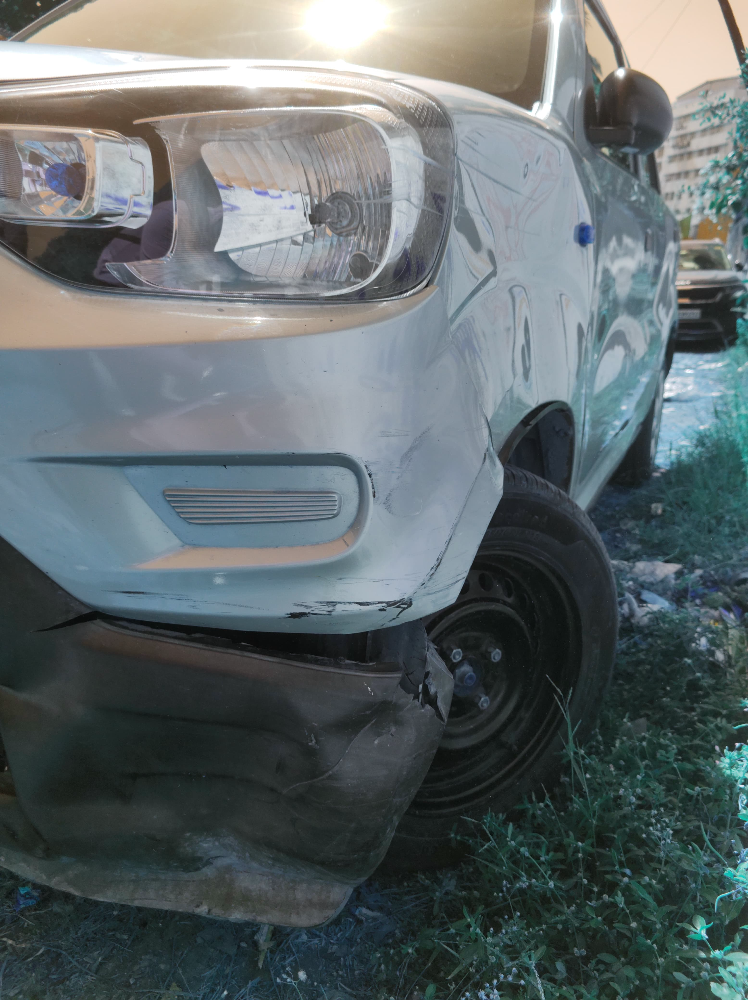

Detected Image:


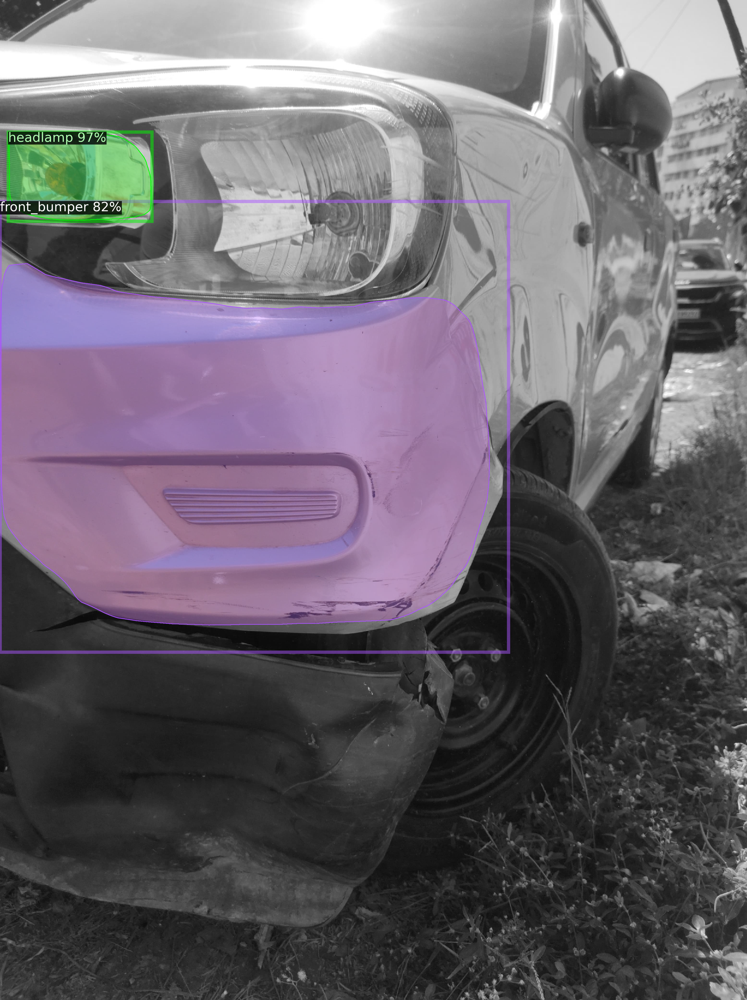

Total Repair Cost: Rs 2225


In [39]:
# image path
image_path = "/content/real_img.jpeg"

# Call the function
Original_image, detected_image, repair_cost = car_damage_and_repair_cost_estimation(image_path, predictor, repair_cost_model)

# Display the original image
print("Original Image:")
img=cv2.imread(image_path)
cv2_imshow(img[:, :, ::-1])

# Display the detected image
print("Detected Image:")
cv2_imshow(detected_image)

# Display the repair cost
print(f"Total Repair Cost: Rs {repair_cost:.0f}")